In [1]:
import os
import re
import ast
import ujson
import copy
import gzip
import tqdm
import pickle
import random
import xenopict
import numpy as np
import pandas as pd
import networkx as nx
from rdkit import Chem
from icecream import ic
import xenosite.fragment
from random import randint
from xenopict import magic
from smart_open import open
from rdkit.Chem import rdFMCS
from xenopict import Xenopict
import pandas.io.formats.style
import matplotlib.pyplot as plt
from scipy.stats import hypergeom
from collections import defaultdict
from xenosite.fragment import Fragment
from typing import NamedTuple, Callable
from xenosite.fragment.remap import serialize_and_remap
from rdkit.Chem.TemplateAlign import AlignMolToTemplate2D
from xenosite.fragment import RingFragmentNetworkX, FragmentNetworkX

from xenosite.fragment import rdkit_warnings
rdkit_warnings(False)

import rdkit.Chem.rdDepictor 
from rdkit.Chem.rdFMCS import FindMCS

# Load in Propogated Rids Set

In [2]:
prid = pd.read_csv(os.environ["FRAGMENT_DATA_DIR"] + 'propogated_bioactivation_dataset.csv', sep='\t', header=None).set_index(0)

# Converts the string into a list of tuples with the value sbeing (rid, level)
prid[1] = [ast.literal_eval(x) for x in prid[1]]

prid

,1
0,
O=C(Br)C(F)(F)F,"[(1, 0)]"
FC(F)(F)C(Cl)Br,"[(4, 1)]"
CC(C)C(Br)C(=O)NC(N)=O,"[(3, 0), (3, 1)]"
CC(C)C(Br)C(=O)O,"[(3, 0)]"
BrC1=CC(Br)=C(Oc2cc(Br)c(Br)cc2Br)C2OC12,"[(16, 0), (18, 0)]"
...,...
NNc1nncc2cc(O)ccc12,[]
Cc1nnc2c3ccccc3c(=NN)[nH]n12,[]
NN=c1[nH]n2c(CO)nnc2c2ccccc12,[]


In [3]:
with gzip.open(os.environ["FRAGMENT_DATA_DIR"] + 'propogated_bioactivation_set_dict.pkl.gz', 'rb') as f:
    prid_dict = pickle.load(f)

prid_dict

{'O=C(Br)C(F)(F)F': {'rids': [1], 'levels': [0]},
 'FC(F)(F)C(Cl)Br': {'rids': [4], 'levels': [1]},
 'CC(C)C(Br)C(=O)NC(N)=O': {'rids': [3, 3], 'levels': [0, 1]},
 'CC(C)C(Br)C(=O)O': {'rids': [3], 'levels': [0]},
 'BrC1=CC(Br)=C(Oc2cc(Br)c(Br)cc2Br)C2OC12': {'rids': [16, 18],
  'levels': [0, 0]},
 'Brc1ccc(Oc2cc(Br)c(Br)cc2Br)c(Br)c1': {'rids': [2,
   3,
   4,
   6,
   7,
   8,
   12,
   17,
   2,
   3,
   7,
   8,
   12,
   17,
   1,
   2,
   3,
   4,
   6,
   7,
   8,
   10,
   12,
   13,
   15,
   17,
   1,
   2,
   3,
   4,
   6,
   7,
   8,
   10,
   12,
   13,
   15,
   17],
  'levels': [1,
   1,
   1,
   1,
   1,
   1,
   1,
   1,
   2,
   2,
   2,
   2,
   2,
   2,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4]},
 'BrC1=CC(Br)=C(Oc2ccc(Br)cc2Br)C2OC12': {'rids': [9, 15], 'levels': [0, 0]},
 'Brc1ccc(Oc2ccc(Br)cc2Br)c(Br)c1': {'rids': [2, 3, 7, 8],
  'levels': [1, 1, 1, 1]},
 'O=C1C

In [ ]:
mol = 'CCCCOC(=O)Oc1ccc(NC(C)=O)cc1'

In [80]:
with gzip.open(os.environ["FRAGMENT_DATA_DIR"] + 'topological_propogated_reactive_ids.pkl.gz', 'rb') as f:
    new_prid = pickle.load(f)

new_prid

1298

In [74]:
prid

,1
0,
O=C(Br)C(F)(F)F,"[(1, 0)]"
FC(F)(F)C(Cl)Br,"[(4, 1)]"
CC(C)C(Br)C(=O)NC(N)=O,"[(3, 0), (3, 1)]"
CC(C)C(Br)C(=O)O,"[(3, 0)]"
BrC1=CC(Br)=C(Oc2cc(Br)c(Br)cc2Br)C2OC12,"[(16, 0), (18, 0)]"
...,...
NNc1nncc2cc(O)ccc12,[]
Cc1nnc2c3ccccc3c(=NN)[nH]n12,[]
NN=c1[nH]n2c(CO)nnc2c2ccccc12,[]


# Load AMD data (contains mols parents and children) into a networkx DiGraph

In [4]:
class AMDLoadingData(NamedTuple):
  graph : nx.DiGraph
  parent_errors : list[str]
  child_errors : list[str]

# Parents and children
def load_AMD(pathname) -> AMDLoadingData:
  with open(pathname, 'rb') as f:
    raw_AMD = ujson.load(f)

  G = nx.DiGraph()

  parent_errors = []
  child_errors =[]

  for node in tqdm.tqdm(raw_AMD['data']):
    if not (mol := Chem.MolFromSmiles(node["smiles"])):
      parent_errors.append(node["smiles"])
      continue

    smi = Chem.MolToSmiles(mol, isomericSmiles=False, canonical=True)

    G.add_node(smi)
    G.nodes[smi]['levels'] = []
    G.nodes[smi]['rids'] = []

    for child in node["children"]:
      if not (mol := Chem.MolFromSmiles(child)):
        child_errors.append(child)
        continue
      
      child_smi = Chem.MolToSmiles(mol,isomericSmiles=False, canonical=True)

      if smi != child_smi:
        G.add_edge(smi, child_smi)
    
  return AMDLoadingData(G, parent_errors, child_errors)

_AMD = load_AMD(os.environ["FRAGMENT_DATA_DIR"] + "/amd_data.json.gz")

100%|██████████| 67159/67159 [00:23<00:00, 2918.32it/s]


# Add mol rids and levels to AMD network

In [5]:
# Use a deepcopy so that the network does not have to be loaded each time while testing
AMD = copy.deepcopy(_AMD)

#### Helper function to get the rid and level data from the propogated rid dataset

In [6]:
def get_rids_and_levels(mol, propogated_rids):
    return [i[0] for i in propogated_rids.loc[mol].tolist()[0]], [i[1] for i in propogated_rids.loc[mol].tolist()[0]]

In [7]:
# For each mol in the propogated rids list
# Add the rid and level data to the node with the mol as its name  if it already exits in the network
# If not, add the mol node then add the data
def add_rid_lvl_data(graph, propogated_rids):
    for each in tqdm.tqdm(list(propogated_rids.index)):
        rids, levels = get_rids_and_levels(each, propogated_rids)

        if each in list(graph.nodes()):
            graph.nodes[each]['rids'] = rids
            graph.nodes[each]['levels'] = levels
        else:
            graph.add_node(each)

            graph.nodes[each]['rids'] = rids
            graph.nodes[each]['levels'] = levels

In [8]:
add_rid_lvl_data(AMD.graph, prid)

100%|██████████| 20957/20957 [00:14<00:00, 1449.82it/s]


In [8]:
# Another AMD copy so the AMD network with rid data does not have to be reloaded while testing
# test_AMD = copy.deepcopy(AMD)

# Fragment network

#### Load in the ring fragment network

In [9]:
#  Frag maximum size is 12
with gzip.open(os.environ["FRAGMENT_DATA_DIR"] + 'network_max_size_12.pkl.gz', 'rb') as f:
    net = pickle.load(f)

net

#### Convert the ring fragment network into a dataframe

In [10]:
def display(info):
  frag = info.name
  #frag = re.sub(":", "", frag)
  # frag = re.sub(r"\[nH\]", "n", frag)
  try:
    m = Chem.MolFromSmarts(frag)
    assert m, "Fragment did not produce mol: " + frag

    x = xenopict.Xenopict(m)
    x.shade(np.minimum(info["marked_ids"] / info["n_mol"], 1))
    return x
  except Exception as e:
    return e

from rdkit.Chem import rdFMCS

def tanimoto(m1, m2, cutoff=0):
  A = m1.GetNumAtoms()
  B = m2.GetNumAtoms()

  if min(A,B) / max(A,B) < cutoff: return 0

  AnB = rdFMCS.FindMCS([m1, m2]).numAtoms
  return AnB / (A + B - AnB) 

def non_max_filter(frags, cutoff=0.7, num=50):
  leaders = []
  for frag in frags:
    m = Chem.MolFromSmarts(frag)

    skip = False

    for l, _ in leaders:
      T = tanimoto(m, l, cutoff=cutoff)
      if T > cutoff:
        skip = True
        break

    if skip: continue
    
    leaders.append((m, frag))

    if len(leaders) >= num: break
    
  return [f for _, f in leaders]

def table(df, score="score", cols=[], num=10, cutoff=0.7):
  df = df.sort_values([score], ascending=False)

  nms = non_max_filter(df.index,num=num, cutoff=cutoff)

  df = df.loc[nms]
  df["disp"] = df.apply(display,axis=1)
  df = df[["disp", score] + cols]

  return df.style

In [85]:
frag = 'C-O-c1:c:c:c(-N-C=O):c:c:1'

# display(frag)

AttributeError: 'str' object has no attribute 'name'

In [11]:
def stats(df):
  df["atom_logp"] = -hypergeom.logsf(df["n_mark_cover"]-1,df["n_atom"],df["n_mark"],df["n_cover"])

  for beta in [1,10,100,1000]:
    df[f"posterior{beta}"] = (df["marked_count"]   ) / (df["count"] + beta)
  
  df["score"] = df["atom_logp"] * df["posterior1"]

In [12]:
network = net.to_pandas()

stats(network)

In [13]:
network.sort_values(by=['posterior1'], ascending=False)

,count,marked_count,n_mol,n_mol_marked,n_atom,n_mark,n_cover,n_mark_cover,exp,obs,marked_ids,size,atom_logp,posterior1,posterior10,posterior100,posterior1000,score
frag,,,,,,,,,,,,,,,,,,
F-c1:c:n:c:n(-C=O):c:1,33.888889,33.888889,33,33,603,66,305,66,26.319714,33,"[0, 0, 11, 0, 33, 0, 0, 0, 26]",9,48.890884,0.971338,0.772152,0.253112,0.032778,47.489553
O=C-n1:c:c(-F):c:n:c:1=O,33.800000,33.800000,33,33,603,66,338,66,27.785635,33,"[0, 0, 0, 26, 0, 0, 11, 0, 33, 0]",10,41.313123,0.971264,0.771689,0.252616,0.032695,40.125964
O=C-n1:c:c(-F):c(=O):n:c:1=O,26.000000,26.000000,26,26,495,52,286,52,22.222763,26,"[0, 0, 0, 26, 0, 0, 0, 0, 0, 26, 0]",11,30.691371,0.962963,0.722222,0.206349,0.025341,29.554654
O=C-n1:c:n:c(=O):c(-F):c:1,26.000000,26.000000,26,26,495,52,260,52,21.222620,26,"[0, 0, 0, 26, 0, 0, 0, 0, 0, 26]",10,36.179363,0.962963,0.722222,0.206349,0.025341,34.839387
C-O-C-n1:c:c:c:n:c:1=O,22.000000,22.000000,22,22,373,44,220,44,18.673474,22,"[0, 0, 0, 0, 15, 0, 7, 0, 22, 0]",10,25.204127,0.956522,0.687500,0.180328,0.021526,24.108295
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
C-C1-O-C(-O-C2(-C)-C-C-C-C-C-2)-C(-O)-C-C-1-O,2.000000,0.000000,2,0,48,0,34,0,0.000000,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, ...",17,-0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000
C-C1-C-C-C-C(-O-1)-O-C1(-C)-C-C-C(=C)-C-C-1,1.000000,0.000000,1,0,24,0,16,0,0.000000,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",16,-0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000
O=C-C1-C-C-C-C(-O-1)-O-C1(-C)-C-C-C-C-C-1,2.000000,0.000000,2,0,48,0,32,0,0.000000,0,"[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]",16,-0.000000,0.000000,0.000000,0.000000,0.000000,-0.000000


In [11]:
# 3. Function frag -> display of info about fragment, including a few molecules that ARE and ARE NOT bioactivated (AT THE SITE OF FRAGMENT!) along with ALL their children.
# - Find all molecules that contain fragment (net.contains_fragment)
# - Determing IDs where fragment is in each molecule
# - Determinine which molecules do and do not have propogated ID overlapping fragment IDs
# - Randomly pick N molecules that DO and DO NOT overlap
# - For each picked molecule, display all children (all generations) WITH progogated IDs marked/circled.

# Checking which mols a fragment overlaps

#### Fragment information display

In [14]:
def display_frag_info(frag):
    frag_display = pd.DataFrame(network.loc[frag])
    marked = [i for i,a in enumerate(list(frag_display.loc['marked_ids'])[0])]

    frag_display.loc['image'] = Xenopict(frag).mark_atoms(marked)

    return frag_display.style

#### Helper Cache functions

In [15]:
def cache_function_call(func):
    cache = {}

    def wrapper(*args, **kwargs):
        key = args
        if key in cache: return cache[key]
        else: 
            output = func(*args, **kwargs)
            cache[key] = output
            return output
    
    wrapper.cache = cache

    return wrapper

@cache_function_call
def get_rdkit_mol(smi):
    return Chem.MolFromSmiles(smi)

@cache_function_call
def get_rdkit_frag(frag):
    return Chem.MolFromSmarts(frag)

@cache_function_call
def get_frag_matches(mol, frag, max_size=12, ring=True):
    if ring: net = RingFragmentNetworkX
    else: net = FragmentNetworkX
    return net(mol, max_size=max_size)._frag2id[frag]

In [16]:
smiles = "CCCCOC(=O)Oc1ccc(NC(C)=O)cc1"
fragment = 'C-O-c1:c:c:c(-N-C=O):c:c:1'



fragment in RingFragmentNetworkX(smiles, max_size=12).network.nodes


def matches_fragment(smiles, fragment, max_size=12, ring=True):
    if ring: net = RingFragmentNetworkX
    else: net = FragmentNetworkX
    return net(smiles, max_size=max_size)._frag2id[fragment]

matches_fragment(smiles, fragment, max_size=12, ring=True)[0]

[5, 7, 8, 9, 10, 11, 12, 13, 15, 16, 17]

#### Caches for storing the mols that did and did not overlap with the selected fragment

In [17]:
# Key: Frag
# Value: Another dict (described below)
#       {Key: mol that has rids that overlap with the frag-mol matched ids
#        Value: matched_mol_rids, rids that the fragment overlaps in the mol}
overlapping_mols: dict[str, dict] = {}

# Dict that uses the frag as a key and a set of mols that do not overlap as 
# Key: Frag
# Value: Set of mols that do not have rids that overlap with the frag-mol matched ids
non_overlapping_mols: dict[str, set] = {}

# Mols that do not appear in the network,  propogated rid mols, nor the old bioactivation dataset but do appear in the contains_fragment list
error_mols = set()

#### Functions to check which mols a fragment overlaps

In [ ]:
# old overlap
def fragment_mol_overlap(frag, rid: int, mol, graph, overlapping_mols_cache=overlapping_mols, non_overlapping_mols_cache=non_overlapping_mols, error_mols_cache=error_mols):
    try:
        mol_rids = graph.nodes[mol]['rids']
    except:
        error_mols_cache.add(mol)
        return

    matches = get_frag_matches(mol, frag)

    for match in matches:
        # for item in mol_rids:
        #   if item in match:
        #       return True
        if any(item in match for item in mol_rids):
            overlapping_rids = [item for item in mol_rids if item in match]

            if frag in overlapping_mols_cache:
                if mol not in overlapping_mols_cache[frag]:
                    overlapping_mols_cache[frag][mol] = [overlapping_rids]
                else:
                    overlapping_mols_cache[frag][mol].append(overlapping_rids)
            else:
                overlapping_mols_cache[frag] = {mol: [overlapping_rids]}
                # overlapping_mols_cache[frag] = {"mol": mol, "matched_mol_rids": [item for item in mol_rids if item in match]}

        else:
            if frag in non_overlapping_mols_cache:
                non_overlapping_mols_cache[frag].add(mol)
            else:
                non_overlapping_mols_cache[frag] = set()
                non_overlapping_mols_cache[frag].add(mol)

In [18]:
def translate_rid(rid, match):
    return match[rid]

In [19]:
def fragment_mol_overlap(frag, rid, mol, graph, overlapping_mols_cache=overlapping_mols, non_overlapping_mols_cache=non_overlapping_mols, error_mols_cache=error_mols):
    try:
        mol_rids = graph.nodes[mol]['rids']
    except:
        error_mols_cache.add(mol)
        return

    matches = get_frag_matches(mol, frag)

    for match in matches:
        rid_to_mol = translate_rid(rid, match)
        
        if rid_to_mol in mol_rids:
            overlapping_rid = rid_to_mol

            if frag in overlapping_mols_cache:
                if mol not in overlapping_mols_cache[frag]:
                    overlapping_mols_cache[frag][mol] = [overlapping_rid]
                else:
                    overlapping_mols_cache[frag][mol].append(overlapping_rid)
            else:
                overlapping_mols_cache[frag] = {mol: [overlapping_rid]}
                # overlapping_mols_cache[frag] = {"mol": mol, "matched_mol_rids": [item for item in mol_rids if item in match]}

        else:
            if frag in non_overlapping_mols_cache:
                non_overlapping_mols_cache[frag].add(mol)
            else:
                non_overlapping_mols_cache[frag] = set()
                non_overlapping_mols_cache[frag].add(mol)

def fragment_mol_overlap_all(frag, rid, frag_network, graph, overlapping_mols_cache=overlapping_mols, non_overlapping_mols_cache=non_overlapping_mols, error_mols_cache=error_mols):
    for i, mol in tqdm.tqdm(enumerate(list(frag_network.contains_fragment(frag)))):
        fragment_mol_overlap(frag, rid, mol, graph, overlapping_mols_cache, non_overlapping_mols_cache)

In [20]:
frag = 'C-O-c1:c:c:c(-N-C=O):c:c:1'

fragment_mol_overlap_all(frag, 2, net, AMD.graph)

81it [00:12,  6.45it/s]


In [21]:
overlapping_mols

{'C-O-c1:c:c:c(-N-C=O):c:c:1': {'CCOc1ccc(NC(C)=O)cc1': [3],
  'CC(=O)Nc1ccc(OC(=O)c2ccccc2OC(C)=O)cc1': [7],
  'COCCOC(=O)Oc1ccc(NC(C)=O)cc1': [8],
  'COc1ccccc1OCC(O)CNC(=O)Oc1ccc(NC(C)=O)cc1': [17],
  'CC(=O)Nc1ccc(OC(=O)Nc2cc(Cl)ccc2O)cc1': [7],
  'CC(=O)Nc1ccc(OCCOC(=O)c2ccccc2OC(C)=O)cc1': [7],
  'CC(=O)Nc1ccc(OC(=O)c2ccc(CN)cc2)cc1': [7],
  'CC(=O)Nc1ccc(OC(C)(C)C)cc1': [7],
  'CCCCOc1ccc(NC(C)=O)cc1': [5],
  'CC(=O)Nc1ccc(OC(=O)CCCO[N+](=O)[O-])cc1': [7],
  'CC(=O)Nc1ccc(OCC(O)CNC(C)C)cc1': [7],
  'CC(=O)Nc1ccc(OC(=O)c2ccc(CN(C)C)cc2)cc1': [7],
  'CCOC(=O)Oc1ccc(NC(C)=O)cc1': [6],
  'CC(=O)Nc1ccc(OC(=O)c2ccc(CCN3CCOCC3)cc2)cc1': [7],
  'CCCOc1ccc(NC(C)=O)cc1': [4],
  'CC(=O)Nc1ccc(OC(=O)C2CCC(=O)N2)cc1': [7],
  'CC(=O)Nc1ccc(OC(=O)NCC(O)COc2cc(C)cc(C)c2)cc1': [7],
  'CC(=O)Nc1ccc(OC(=O)c2cccc(CN3CCN(C)CC3)c2)cc1': [7],
  'CCOc1ccc(NC(=O)CC(C)O)cc1': [3],
  'CCCCCCOC(=O)Oc1ccc(NC(C)=O)cc1': [10],
  'COCC(C)OC(=O)Oc1ccc(NC(C)=O)cc1': [9],
  'CC(=O)Nc1ccc(OC(=O)Nc2ccc(C(=O)c3ccccc

In [22]:
non_overlapping_mols

{'C-O-c1:c:c:c(-N-C=O):c:c:1': {'*C(=O)C(CCC(=O)Oc1ccc(NC(C)=O)cc1)NC(=O)c1ccc(N(C=O)CC2CNc3[nH]c(N)nc(=O)c3N2)cc1',
  '*C(=O)C(N)CCC(=O)Oc1ccc(NC(C)=O)cc1',
  '*C(=O)Oc1ccc(NC(=O)C=C(C)C=CC=C(C)C=CC2=C(C)CCCC2(C)C)cc1',
  '*C1=CC(NCc2ccnc3ccccc23)=C(C(=O)Nc2ccc(OC(F)(F)F)cc2)S1=O',
  '*OC(=O)COc1ccc(NC(C)=O)cc1',
  '*Oc1ccccc1C(=O)OCCOc1ccc(NC(C)=O)cc1',
  'CC(=O)CCOc1ccc(NC(C)=O)cc1',
  'CC(=O)NC(CSC1=CC(NCc2ccnc3ccccc23)=C(C(=O)Nc2ccc(OC(F)(F)F)cc2)S1=O)C(=O)O',
  'CC(=O)NC(CSC1CC(NCc2ccnc3ccccc23)=C(C(=O)Nc2ccc(OC(F)(F)F)cc2)S1=O)C(=O)O',
  'CC(=O)NCC(=O)Oc1ccc(NC(C)=O)cc1',
  'CC(=O)Nc1ccc(OC(=O)C=C(C)C=CC=C(C)C=CC2=C(C)CCCC2(C)C)cc1',
  'CC(=O)Nc1ccc(OC(=O)c2ccccc2O)cc1',
  'CC(=O)Nc1ccc(OC(C)=O)cc1',
  'CC(=O)Nc1ccc(OC(C)O)cc1',
  'CC(=O)Nc1ccc(OCC(=O)O)cc1',
  'CC(=O)Nc1ccc(OCC(C)O)cc1',
  'CC(=O)Nc1ccc(OCC(O)CNC(C)C)cc1O',
  'CC(=O)Nc1ccc(OCC(O)CNC(C)C)cc1OC1OC(C(=O)O)C(O)C(O)C1O',
  'CC(=O)Nc1ccc(OCCC(C)O)cc1',
  'CC(=O)Nc1ccc(OCCO)cc1',
  'CC(=O)Nc1ccc(OCCOC(=O)c2ccccc2O)cc1

In [23]:
error_mols

{'CC(=O)Nc1ccc(OC(=O)c2ccc(C[N+](C)(C)C)cc2)cc1'}

#### Save the overlapping and non overlapping data

In [20]:
# with smart_open.open("overlapping_mols.pkl.gz", 'wb') as f:
#     pickle.dump(overlapping_mols, f)

# with smart_open.open("non_overlapping_mols.pkl.gz", 'wb') as f:
#     pickle.dump(non_overlapping_mols, f)

# Randomly choosing mols that do and do not overlap the chosen fragment

#### Picks a certain number of mols that do and dont overlap and nonoverlap with fragment rids

In [24]:
def random_mol_indices(overlap_len, non_overlap_len, num=2):
    overlap_indices = []
    for i in range(0, num):
        overlap_indices.append(random.randint(0, overlap_len))

    non_overlap_indices = []
    for i in range(0, num):
        non_overlap_indices.append(random.randint(0, non_overlap_len))

    return overlap_indices, non_overlap_indices

def random_mols(frag, overlap_indices, non_overlap_indices, overlap_mols=overlapping_mols, non_overlap_mols=non_overlapping_mols):
    overlapping_mols_list = list(overlap_mols[frag])
    non_overlapping_mols_list = list(non_overlap_mols[frag])

    ov_output = []
    non_ov_output = []
    for i,j in zip(overlap_indices, non_overlap_indices):
        ov_output.append(overlapping_mols_list[i])
        non_ov_output.append(non_overlapping_mols_list[i])
    
    return ov_output, non_ov_output

In [22]:
# random_indices = random_mol_indices()

# ov_random_mols, non_ov_random_mols = random_mols(frag, random_indices[0], random_indices[1], overlap_mols=overlapping_mols, non_overlap_mols=non_overlapping_mols)
# ov_random_mols, non_ov_random_mols

# Descendants Traversal

#### BFS traversal to find each descendant of a particular mol

In [25]:
def bfs_descendant_edges(graph: nx.DiGraph, node):
    for parent, child in nx.bfs_edges(graph, source=node):
        yield parent, child

def bfs_descendants(graph: nx.DiGraph, node):
    for parent, child in bfs_descendant_edges(graph, node):
        if parent == child: continue
        yield child

def descendant_generations(graph: nx.DiGraph, node) -> defaultdict:
    generation : dict[str, generation] = {}
    generation[node] = 0

    for parent, child in bfs_descendant_edges(graph, node):
        if child in generation: continue
        
        generation[child] = generation[parent] + 1

    output = defaultdict(list)

    for node, gen in generation.items():
        output[gen].append(node)

    return output

def get_children(graph, mol):
    return list(graph.successors(mol))

In [148]:
prid_dict

{'O=C(Br)C(F)(F)F': {'rids': [1], 'levels': [0]},
 'FC(F)(F)C(Cl)Br': {'rids': [4], 'levels': [1]},
 'CC(C)C(Br)C(=O)NC(N)=O': {'rids': [3, 3], 'levels': [0, 1]},
 'CC(C)C(Br)C(=O)O': {'rids': [3], 'levels': [0]},
 'BrC1=CC(Br)=C(Oc2cc(Br)c(Br)cc2Br)C2OC12': {'rids': [16, 18],
  'levels': [0, 0]},
 'Brc1ccc(Oc2cc(Br)c(Br)cc2Br)c(Br)c1': {'rids': [2,
   3,
   4,
   6,
   7,
   8,
   12,
   17,
   2,
   3,
   7,
   8,
   12,
   17,
   1,
   2,
   3,
   4,
   6,
   7,
   8,
   10,
   12,
   13,
   15,
   17,
   1,
   2,
   3,
   4,
   6,
   7,
   8,
   10,
   12,
   13,
   15,
   17],
  'levels': [1,
   1,
   1,
   1,
   1,
   1,
   1,
   1,
   2,
   2,
   2,
   2,
   2,
   2,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   3,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4,
   4]},
 'BrC1=CC(Br)=C(Oc2ccc(Br)cc2Br)C2OC12': {'rids': [9, 15], 'levels': [0, 0]},
 'Brc1ccc(Oc2ccc(Br)cc2Br)c(Br)c1': {'rids': [2, 3, 7, 8],
  'levels': [1, 1, 1, 1]},
 'O=C1C

In [ ]:
'''
Pick a top fragment
Show examples how a specifc rid becomes activated
DFS with least amout of edges to show bioactivation
'''

In [ ]:
'''
1) DFS Search to create rid line:
    I already checked if there are molecules that overlap with the fragment's particular rid when matched

    How to check if that rid in the matched mol is propogated? propogated rids dataset
    Shows how an rid travels up from level 0

    In the AMD graph, the mol node should have every rid and level. Isolate the rid in the node data

    Do a dfs. If the mols in the search do not have that particular rid (transalate to correct index for each mol), do not yield it

    That should remove most if not all unnessecary mols to then create the rid line. Next would be to find the rid line that is the shortest

2) 10-fold cross validation
    Shuffle the dataset randomly.
        propogated_bioactivation_dataset

    Split the dataset into k groups
        10

    For each unique group:
        Take the group as a hold out or test data set
            1 group out of 10 10 times

        Take the remaining groups as a training data set
            Training to do what exactly? Find which approach works best for 

        Fit a model on the training set and evaluate it on the test set
            What model? 

        Retain the evaluation score and discard the model

        Summarize the skill of the model using the sample of model evaluation scores
'''

In [37]:
# TODO
frag = 'C-O-c1:c:c:c(-N-C=O):c:c:1'
mol = 'CCOc1ccc(NC(C)=O)cc1'
graph = AMD.graph

rids = graph.nodes[mol]['rids']
lvl = graph.nodes[mol]['levels']

drill_down_rids = []
for r,l in zip(rids,lvl):
    for ov_rids in overlapping_mols[frag][mol]:
        if r == ov_rids:
            drill_down_rids.append((r,l))

for parent, child in nx.dfs_edges(graph, mol):
    parent_match = matches_fragment(parent, frag)
    child_match = matches_fragment(child, frag)

    for pm in parent_match:
        for cm in child_match:
            
#         for dd_rid, _ in drill_down_rids:
#             trid = translate_rid(dd_rid, m)

[[1, 2, 3, 4, 5, 6, 7, 8, 10, 11, 12]] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []
[] []


KeyboardInterrupt: 

In [40]:
# Alternative for drill down with one rid?
ov_graph_list = [(i, AMD.graph.nodes[i]) for i in overlapping_mols[frag]]

for m, data in ov_graph_list:
    edges = AMD.graph.edges(m)
    if any(item in edges for item in overlapping_mols[frag]):
        print([item for item in overlapping_mols[frag] if item in edges])

In [147]:
frag = 'C-O-c1:c:c:c(-N-C=O):c:c:1'
mol = 'CCOc1ccc(NC(C)=O)cc1'

def dfs_descendant_edges(graph: nx.DiGraph, node, frag):
    for parent, child in nx.dfs_edges(graph, source=node):
        if parent in overlapping_mols[frag] and child in overlapping_mols[frag]:
            yield parent, child

# def dfs_ancestor_edges(graph: nx.DiGraph, node, frag):
#     for child, parent in nx.dfs_edges(graph.reverse(), source=node):
#         if parent in overlapping_mols[frag] and child in overlapping_mols[frag]:
#             yield parent, child

print(1, list(dfs_descendant_edges(AMD.graph, mol, frag)))
# print(2, list(dfs_ancestor_edges(AMD.graph, mol, frag)))


# def bfs_descendants(graph: nx.DiGraph, node):
#     for parent, child in bfs_descendant_edges(graph, node):
#         if parent == child: continue
#         yield child

# def descendant_generations(graph: nx.DiGraph, node) -> defaultdict:
#     generation : dict[str, generation] = {}
#     generation[node] = 0

#     for parent, child in bfs_descendant_edges(graph, node):
#         if child in generation: continue
        
#         generation[child] = generation[parent] + 1

#     output = defaultdict(list)

#     for node, gen in generation.items():
#         output[gen].append(node)

#     return output

# def get_children(graph, mol):
#     return list(graph.successors(mol))

1 [('CCOc1ccc(NC(C)=O)cc1', 'CCOc1ccc(N(O)C(C)=O)cc1')]


In [125]:
overlapping_mols[frag]['CCOc1ccc(N(O)C(C)=O)cc1']

[3]

# Display Descendants

#### Use the random mols and use that to show one or all generations

In [18]:
# The word "conjugation" is derived from a Latin word that means "to link together".
# In organic chemistry terms, it is used to describe the situation that occurs when π
# systems (e.g. double bonds) are "linked together". An "extended" π (pi) system exists
# over a longer series of atoms (e.g. C=C-C=C or C=C-C=O. etc.).

def generation_dataframes(graph, mol):
    gen_dfs = []
    dg = descendant_generations(graph, mol)

    for gen in dg:
        df = pd.DataFrame(columns=['mol', 'mol_generation', 'rids', 'levels'])

        for each in dg[gen]:
            rids = graph.nodes[each]['rids']
            levels = graph.nodes[each]['levels']

            df.loc[len(df)] = [each, gen, rids, levels]
        
        yield df

def xenopict_workaround(mol_seq, rid_seq):
    image = []
    xenopict_image_error_mols = []

    for mol, rids in zip(mol_seq, rid_seq):     
        try:
            image.append(Xenopict(mol).mark_atoms(rids))
        except ValueError:
            image.append('Xenopict could not create an image for this mol')
            xenopict_image_error_mols.append(mol)
            continue

    return image, xenopict_image_error_mols

def show_generation(gen, graph, mol, remove_no_rids=False, image_size=None):
    try:
        df = list(generation_dataframes(graph, mol))[gen]
    except IndexError:
        print('That generation does not exist!')
        return

    if remove_no_rids:
        df = df[df['rids'].apply(len) > 0]

    # df['image'] = [Xenopict(mol).mark_atoms(rids) for mol, rids in zip(df['mol'], df['rids'])]
    image, xenopict_image_error_mols = xenopict_workaround(df['mol'], df['rids'])

    df['image'] = image
    df = df[['mol', 'mol_generation', 'image', 'rids', 'levels']]

    if image_size:
        return df.style.set_properties(subset=['image'], **{'width': str(image_size) + 'px'}), xenopict_image_error_mols

    return df.style.set_properties(subset=['image'], **{'width': '300px'}), xenopict_image_error_mols

def show_descendant_generations(graph, mol, remove_no_rids=False, image_size=None):
    tmp = generation_dataframes(graph, mol)
    df = pd.concat(tmp).reset_index()

    if remove_no_rids:
        df = df[df['rids'].apply(len) > 0]

    # df['image'] = [Xenopict(mol).mark_atoms(rids) for mol, rids in zip(df['mol'], df['rids'])]
    image = []
    xenopict_image_error_mols = []
    for mol, rids in tqdm.tqdm(zip(df['mol'], df['rids'])):     
        try:
            image.append(Xenopict(mol).mark_atoms(rids))
        except ValueError:
            image.append('Xenopict could not create an image for this mol')
            xenopict_image_error_mols.append(mol)
            continue

    df['image'] = image
    df = df[['mol', 'mol_generation', 'image', 'rids', 'levels']]
    
    if image_size:
        return df.style.set_properties(subset=['image'], **{'width': str(image_size) + 'px'}), xenopict_image_error_mols

    return df.style.set_properties(subset=['image'], **{'width': '300px'}), xenopict_image_error_mols

# Display drill down data

In [19]:
def display_frag_info(frag, frag_network_df):
    frag_display = pd.DataFrame(frag_network_df.loc[frag])
    marked = [i for i,a in enumerate(list(frag_display.loc['marked_ids'])[0])]

    frag_display.loc['image'] = Xenopict(frag).mark_atoms(marked)

    return frag_display.style

In [26]:
# frag = 'c1:c:c:c:c:c:1'

# type(display_frag_info(frag, network))

#### Main function to run the whole process

In [20]:
class Display(NamedTuple):
    frag_info: pd.io.formats.style.Styler
    overlapping_mols: dict[str, dict]
    non_overlapping_mols: dict[str, list]
    error_mols: set
    ov_random_mols: list
    non_ov_random_mols: list
    ov_df: list[pd.io.formats.style.Styler]
    no_ov_df: list[pd.io.formats.style.Styler]
    ov_error_mols: list[list]
    non_ov_error_mols: list[list]

def main(frag, propogated_rid_csv, amd_mols_json, frag_network_pkl):
    # Load the propogated rids and levels
    print('Loading propogated rids and levels...')
    prid = pd.read_csv(propogated_rid_csv, sep='\t', header=None).set_index(0)
    prid[1] = [ast.literal_eval(x) for x in prid[1]]

    # Load the AMD network
    print('Loading the AMD network...')
    amd = load_AMD(amd_mols_json)

    # Add the propogated rid data to the AMD network
    print('Adding the propogated rid data to the AMD network...')
    add_rid_lvl_data(amd.graph, prid)

    # Load in the fragment network
    print('Loading in the fragment network...')
    with gzip.open(frag_network_pkl, 'rb') as f:
        net = pickle.load(f)

    # Display fragement data
    # print('Displaying fragment info...')
    frag_info = display_frag_info(frag, net.to_pandas())
    # display(frag_info)

    # Discover the molecules' rids that the fragment overlaps
    print('Finding the molecules with rids that overlap with the matched fragment ids...')
    overlapping_mols: dict[str, dict] = {}
    non_overlapping_mols: dict[str, list] = {}
    error_mols = set()

    fragment_mol_overlap_all(frag, net, amd.graph, overlapping_mols_cache=overlapping_mols, non_overlapping_mols_cache=non_overlapping_mols, error_mols_cache=error_mols)

    # Pick random molecuels that do and do not overlap 
    print('Picking random molecules that do and do not overlap...')
    random_indices = random_mol_indices(len(overlapping_mols[frag]), len(non_overlapping_mols[frag]))
    ov_random_mols, non_ov_random_mols = random_mols(frag, random_indices[0], random_indices[1], overlap_mols=overlapping_mols, non_overlap_mols=non_overlapping_mols)
    print('The mol(s) that had rids that overlapped the fragment match ids were:', ov_random_mols)
    print('The mol(s) that did not have rids that overlapped the fragment match ids were:', non_ov_random_mols)

    print('\n\nGenerating display data...')

    # Display the data of the random mmolecules selected
    # print('Displaying overlapping molecule data...')
    ov_df_list = []
    ov_error_list = []
    for mol in ov_random_mols:
        ov_df, ov_error_mols = show_descendant_generations(amd.graph, mol)
        # print('\n\nThis is the descendants data for', mol)
        # display(ov_df)
        ov_df_list.append(ov_df)
        ov_error_list.append(ov_error_mols)

    # print('Displaying nonoverlapping molecule data...')
    non_ov_df_list = []
    non_ov_error_list = []
    for mol in non_ov_random_mols:
        non_ov_df, non_ov_error_mols = show_descendant_generations(amd.graph, mol)
        # print('\n\nThis is the descendants data for', mol)
        # display(non_ov_df)
        non_ov_df_list.append(non_ov_df)
        non_ov_error_list.append(non_ov_error_mols)

    print('\n\nDrill down and displays finished!')

    return Display(frag_info, overlapping_mols, non_overlapping_mols, error_mols, ov_random_mols, non_ov_random_mols, ov_df_list, non_ov_df_list, ov_error_list, non_ov_error_list)

In [44]:
environ_dir = os.environ["FRAGMENT_DATA_DIR"]

frag = 'C-O-c1:c:c:c(-N-C=O):c:c:1'
prid = environ_dir + 'propogated_bioactivation_dataset.csv'
amd = environ_dir + "/amd_data.json.gz"
frag_network = environ_dir + 'network_max_size_12.pkl.gz'

display_output = main(frag, prid, amd, frag_network)

Loading propogated rids and levels...
Loading the AMD network...


100%|██████████| 67159/67159 [00:22<00:00, 3048.24it/s]


Adding the propogated rid data to the AMD network...


100%|██████████| 20957/20957 [00:14<00:00, 1432.50it/s]


Loading in the fragment network...
Finding the molecules with rids that overlap with the matched fragment ids...


81it [00:00, 10114.58it/s]

Picking random molecules that do and do not overlap...
The mol(s) that had rids that overlapped the fragment match ids were: ['CCCCOC(=O)Oc1ccc(NC(C)=O)cc1', 'CCOc1ccc(NC(=O)CC(C)O)cc1']
The mol(s) that did not have rids that overlapped the fragment match ids were: ['CC(=O)Nc1ccc(OCC(=O)O)cc1', '*Oc1ccccc1C(=O)OCCOc1ccc(NC(C)=O)cc1']


Generating display data...



3088it [00:48, 63.12it/s] 
3088it [00:48, 63.64it/s] 
1it [00:00, 93.32it/s]
1it [00:00, 64.87it/s]



Drill down and displays finished!


##### Fragment Info

In [45]:
display_output.frag_info

,C-O-c1:c:c:c(-N-C=O):c:c:1
count,81.000000
marked_count,42.000000
n_mol,81
n_mol_marked,44
n_atom,1894
n_mark,338
n_cover,891
n_mark_cover,288
exp,42.378368
obs,42


##### Mols with rids that did and did not overlap the fragment

In [71]:
prid

'/Users/clint/Desktop/xenosite-fragment/base_data/propogated_bioactivation_dataset.csv'

In [46]:
display_output.overlapping_mols, display_output.non_overlapping_mols

({'C-O-c1:c:c:c(-N-C=O):c:c:1': {'CCOc1ccc(NC(C)=O)cc1': [[1,
     3,
     4,
     5,
     6,
     8,
     11,
     12,
     4,
     5,
     11,
     12,
     1,
     3,
     8,
     1,
     8,
     1,
     8,
     1,
     8,
     1,
     8,
     1,
     8]],
   'CC(=O)Nc1ccc(OC(=O)c2ccccc2OC(C)=O)cc1': [[5,
     6,
     21,
     22,
     4,
     5,
     6,
     7,
     21,
     22,
     1,
     5,
     6,
     7,
     9,
     21,
     22,
     1,
     7,
     9,
     9,
     9,
     9,
     9]],
   'COCCOC(=O)Oc1ccc(NC(C)=O)cc1': [[9,
     10,
     16,
     17,
     8,
     9,
     10,
     11,
     16,
     17,
     8,
     9,
     10,
     13,
     16,
     17,
     8,
     13,
     13,
     13,
     13,
     13]],
   'COc1ccccc1OCC(O)CNC(=O)Oc1ccc(NC(C)=O)cc1': [[18,
     19,
     25,
     26,
     17,
     18,
     19,
     20,
     25,
     26,
     17,
     18,
     19,
     22,
     25,
     26,
     17,
     22,
     22,
     22,
     22,
     22]],
   'CC(=O)Nc1ccc(OC(=O)Nc2c

##### The generation number shows how far away it is in the children family tree from a particular parent, i.e how many generations away
##### 0 = parent, 1 = child, 2 = grandchild, etc.

In [68]:
show_generation(2, AMD.graph, 'CCCCOC(=O)Oc1ccc(NC(C)=O)cc1')[0]

In [48]:
for mol, df in zip(display_output.ov_random_mols, display_output.ov_df):
    print('Mol:', mol)
    print('-----------------------------------------------------------------')
    display(df)
    print('===============================================================================================================================================\n\n\n\n\n')

Mol: CCCCOC(=O)Oc1ccc(NC(C)=O)cc1
-----------------------------------------------------------------







Mol: CCOc1ccc(NC(=O)CC(C)O)cc1
-----------------------------------------------------------------


In [49]:
for mol, df in zip(display_output.non_ov_random_mols, display_output.no_ov_df):
    print('Mol:', mol)
    print('-----------------------------------------------------------------')
    display(df)
    print('===============================================================================================================================================\n\n\n\n\n')

Mol: CC(=O)Nc1ccc(OCC(=O)O)cc1
-----------------------------------------------------------------







Mol: *Oc1ccccc1C(=O)OCCOc1ccc(NC(C)=O)cc1
-----------------------------------------------------------------


##### Mols that did not appear in the AMD graph

In [50]:
display_output.error_mols

set()

##### Mols that Xenopict could not make an image

In [51]:
for mol_list in display_output.ov_error_mols:
    print(mol_list)

['CC(=O)Nc1ccc([O])cc1', 'CC(=O)NC1=C[CH]C(=O)C=C1', '[O]c1ccc(O)cc1', '*NCCO[Y]', 'C[C]=O', '[CH2]O', '[N]=O', 'CC[O]', 'C[CH]O', '[O]NCCc1ccccc1', 'CCC=CCC=CCC(C=CC=CCC=CCCCC(=O)O)O[O]', 'CCC=CCC=CCC=CCC(C=CC=CCCCC(=O)O)O[O]', 'CCC=CCC(C=CC=CCC=CCC=CCCCC(=O)O)O[O]', 'CCC=CC=CC(CC=CCC=CCC=CCCCC(=O)O)O[O]', 'CCC=CCC=CCC=CC=CC(CC=CCCCC(=O)O)O[O]', 'CCC=CCC=CC=CC(CC=CCC=CCCCC(=O)O)O[O]', 'CN1CC(O)c2cc([O])c(O)cc21', 'CC12CCC3c4ccc([O])c(O)c4CCC3C1CCC2=O', 'CC12CCC3C4=C(CCC3C1CCC2=O)C(=O)C([O-])=C[CH]4', 'O[CH]CO']
['CC(=O)Nc1ccc([O])cc1', 'CC(=O)NC1=C[CH]C(=O)C=C1', '[O]c1ccc(O)cc1', '*NCCO[Y]', 'C[C]=O', '[CH2]O', '[N]=O', 'CC[O]', 'C[CH]O', '[O]NCCc1ccccc1', 'CCC=CCC=CCC(C=CC=CCC=CCCCC(=O)O)O[O]', 'CCC=CCC=CCC=CCC(C=CC=CCCCC(=O)O)O[O]', 'CCC=CCC(C=CC=CCC=CCC=CCCCC(=O)O)O[O]', 'CCC=CC=CC(CC=CCC=CCC=CCCCC(=O)O)O[O]', 'CCC=CCC=CCC=CC=CC(CC=CCCCC(=O)O)O[O]', 'CCC=CCC=CC=CC(CC=CCC=CCCCC(=O)O)O[O]', 'CN1CC(O)c2cc([O])c(O)cc21', 'CC12CCC3c4ccc([O])c(O)c4CCC3C1CCC2=O', 'CC12CCC3C4=C(CCC3C1CCC2

In [52]:
for mol_list in display_output.non_ov_error_mols:
    print(mol_list)

[]
[]


In [36]:
# AMD.graph.nodes['NC(=O)N1c2ccccc2C=Cc2ccc(O)cc21']

{'levels': [0, 0], 'rids': [10, 11]}

0 CN1CCN(C2=Nc3cc(F)ccc3Cc3ccccc32)CC1
[8, 12]
yes
1 CN1CCN(C2=Nc3cc(F)ccc3Cc3ccc(SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)cc32)CC1
[]
1 Oc1cc2c(cc1F)N=C(N1CCNCC1)c1ccccc1C2
[]
1 O=S(=O)(O)Oc1cc2c(cc1F)N=C(N1CCNCC1)c1ccccc1C2
[]
1 CN1CCN(C2=Nc3cc(F)c(OC4OC(C(=O)O)C(O)C(O)C4O)cc3Cc3ccccc32)CC1
[]
1 C[N+]1([O-])CCN(C2=Nc3cc(F)c(OS(=O)(=O)O)cc3Cc3ccccc32)CC1
[]
1 CN1CCN(C2=Nc3cc(F)c(OS(=O)(=O)O)cc3Cc3ccccc32)CC1
[]
1 Fc1ccc2c(c1)N=C(N1CCNCC1)c1ccccc1C2
[]
1 C[N+]1([O-])CCN(C2=Nc3cc(F)c(O)cc3Cc3ccccc32)CC1
[]
1 C[N+]1([O-])CCN(C2=Nc3cc(F)ccc3Cc3ccccc32)CC1
[]
1 CN1CCN(C2=Nc3cc(F)c(O)cc3Cc3ccccc32)CC1
[8, 13]
yes
1 C[N+]1([O-])CCN(C2=Nc3cc(F)c(OC4OC(C(=O)O)C(O)C(O)C4O)cc3Cc3ccccc32)CC1
[]
2 CC(=O)NC(CSc1c(F)c(O)cc2c1N=C(N1CCN(C)CC1)c1ccccc1C2)C(=O)O
[]
2 CN1CCN(c2nc3cc(F)c(=O)cc-3cc3ccccc23)CC1
[8, 13]
yes
2 CN1CCN(C2=Nc3c(cc(O)c(F)c3SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)Cc3ccccc32)CC1
[]
2 CN1CCN(C2=Nc3cc(F)c(O)c(SCC(NC(=O)CCC(N)C(=O)O)C(=O)NCC(=O)O)c3Cc3ccccc32)CC1
[]
2 CC(=O)NC(CSc1c(O)c(F)cc

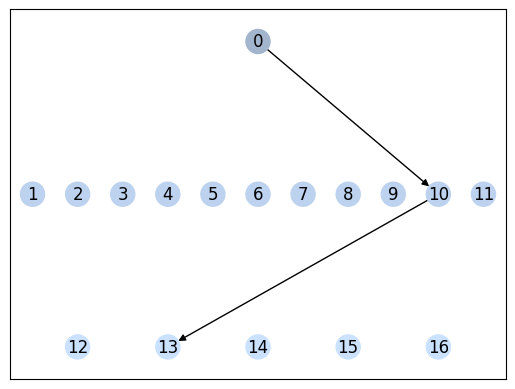

In [37]:
test_mol = 'CN1CCN(C2=Nc3cc(F)ccc3Cc3ccccc32)CC1'
# test_mol = 'CC(=O)OC1Cc2ccccc2N(C(N)=O)c2ccccc21'

def generate_tree(graph, mol, ancestors=False): 
    G = nx.DiGraph()
    cmap = []
    pos=[]
    colors = ['#A2B5CD', '#BCD2EE', '#CAE1FF', '#B0C4DE', '#6495ED', '#27408B', '#3A5FCD', '#436EEE', '#4876FF', '#4169E1', '#3D59AB']
    
    # if ancestors:
    #     ag = list(ancestor_generations(graph, mol).items())
    # else:
    ag = list(descendant_generations(graph, mol).items())

    for key, value in ag:
        for y,v in enumerate(value):
            try:
                cmap.append(colors[key])
            except IndexError:
                cmap.append(colors[len(colors) - 1])

            # if ancestors:
            #     pos.append(((y+1)/(len(value)+1) , key/len(ag) + ((key/len(ag))/2)))
            # else:
            pos.append(((y+1)/(len(value)+1) , 1-(key/len(ag) + ((key/len(ag))/2))))

            G.add_node(v)

    # for i, add in enumerate(ag):
    #     for a in add[1]:
    #         if i+1 < len(ag):
    #             for b in ag[i+1][1]:
    #                 G.add_edge(a,b)

    for key, value in ag:
        for v in value:
            print(key, v)
            print(graph.nodes[v]['rids'])
            if graph.nodes[v]['rids']:
                print('yes')
                if key+1 != len(ag):
                    for next_value in ag[key+1][1]:
                        if graph.nodes[next_value]['rids']:
                            # print(1)
                            G.add_edge(v, next_value)

    return G, cmap, pos

def display_genrational_family_tree(graph, mol):
    _graph, cmap, pos = generate_tree(graph, test_mol)
    G = _graph
    G = nx.convert_node_labels_to_integers(G, label_attribute='canonical_smiles')
    nx.draw_networkx(G, pos=pos, with_labels=True, node_color=cmap)

display_genrational_family_tree(AMD.graph, test_mol)

# Error cases

In [38]:
_AMD = load_AMD(os.environ["FRAGMENT_DATA_DIR"] + "/amd_data.json.gz")

100%|██████████| 67159/67159 [00:23<00:00, 2820.41it/s]


In [39]:
AMD = copy.deepcopy(_AMD)
add_rid_lvl_data(AMD.graph, prid)

TypeError: 'builtin_function_or_method' object is not iterable

In [ ]:
show_generation(0, AMD.graph, 'CCCC1OC2CC(=O)OC2C23OC12C(=O)c1c(O)cccc1C3=O')[0]

In [ ]:
show_generation(5, AMD.graph, 'COC(=O)C(Cc1ccc(OC(C)=O)c(OC(C)=O)c1)NC(=O)CCCCC(=O)NC(Cc1ccc(OC(C)=O)c(OC(C)=O)c1)C(=O)OC', remove_no_rids=False)[1]

['[N]=O']

In [ ]:
show_generation(2, AMD.graph, 'Oc1ccc2c3c1OC1C(O)C=CC4C(C2)NCCC341', remove_no_rids=False)[0]

In [ ]:
Xenopict('C[C]=O')

ValueError: Z

In [ ]:
prid.loc['CC(=O)OCC1CCCN1C(=O)OC[n+]1cnn(CC(O)(c2cc(F)ccc2F)C(C)c2nc(-c3ccc(C#N)cc3)cs2)c1']

KeyError: 'CC(=O)OCC1CCCN1C(=O)OC[n+]1cnn(CC(O)(c2cc(F)ccc2F)C(C)c2nc(-c3ccc(C#N)cc3)cs2)c1'

In [ ]:
AMD.graph.nodes['CC(=O)OCC1CCCN1C(=O)OC[n+]1cnn(CC(O)(c2cc(F)ccc2F)C(C)c2nc(-c3ccc(C#N)cc3)cs2)c1']

KeyError: 'CC(=O)OCC1CCCN1C(=O)OC[n+]1cnn(CC(O)(c2cc(F)ccc2F)C(C)c2nc(-c3ccc(C#N)cc3)cs2)c1'

In [ ]:
frag = 'c1:c:c:c:c:c:1'
# Mols that do not appear in the network,  propogated rid mols, nor the old bioactivation dataset but do appear in the contains_fragment list
fragment_mol_overlap_all(frag, net, AMD.graph, overlapping_mols_cache=overlapping_mols, non_overlapping_mols_cache=non_overlapping_mols, error_mols_cache=error_mols)

13882it [00:00, 602671.80it/s]


In [ ]:
'CC(=O)OCC1CCCN1C(=O)OC[n+]1cnn(CC(O)(c2cc(F)ccc2F)C(C)c2nc(-c3ccc(C#N)cc3)cs2)c1' in list(net.contains_fragment(frag))

True

In [ ]:
environ_dir = os.environ["FRAGMENT_DATA_DIR"]

frag = 'C-C1-C-C-C2-C-C-C-C(-O)-C-2-C-1-C'
prid = environ_dir + 'propogated_bioactivation_dataset.csv'
amd = environ_dir + "/amd_data.json.gz"
frag_network = environ_dir + 'network_max_size_12.pkl.gz'

display_output = main(frag, prid, amd, frag_network)

In [ ]:
environ_dir = os.environ["FRAGMENT_DATA_DIR"]

frag = 'O-C-C-C-[Se]'
prid = environ_dir + 'propogated_bioactivation_dataset.csv'
amd = environ_dir + "/amd_data.json.gz"
frag_network = environ_dir + 'network_max_size_12.pkl.gz'

display_output = main(frag, prid, amd, frag_network)

Loading propogated rids and levels...
Loading the AMD network...


100%|██████████| 67159/67159 [00:21<00:00, 3098.00it/s]


Adding the propogated rid data to the AMD network...


100%|██████████| 20957/20957 [00:14<00:00, 1436.23it/s]


Loading in the fragment network...


ValueError: Z